In [1]:
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.preprocessing import RobustScaler
import os
import numpy as np
import pandas as pd
from scipy.spatial.distance import pdist, squareform
from sklearn.decomposition import KernelPCA
import numpy as np
from sklearn.datasets import load_digits
import matplotlib.pyplot as plt
import time
import numpy as np
from sklearn.datasets import make_s_curve
import matplotlib.pyplot as plt
from sklearn.manifold import LocallyLinearEmbedding
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objs as go
from matplotlib import animation
import plotly
import plotly.express as px

In [23]:
os.chdir(r"C:\Users\13479\Desktop\dataset")

In [25]:
df = pd.read_csv('删减后原数据.csv')
df=data.fillna(0)
y = df.iloc[:,-1]

In [29]:
df

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,90,91,92,93,94,95,96,97,98,99
0,0,-0.001127,-0.000027,-0.000512,0.000005,-0.000007,-0.013992,-0.000000,-0.000000,0.000183,...,0.000000,-0.000000,-0.000000,0.000000e+00,-0.000000e+00,-0.000000,-0.000000,-0.000000,-0.000000,0.000000
1,1,0.808990,0.014577,0.230614,-0.045606,0.003702,0.004060,-0.000049,0.000013,0.083152,...,0.000003,-0.000038,0.000003,-7.601277e-06,-2.793583e-07,-0.000022,0.000042,0.000023,0.000018,0.000003
2,2,0.094779,0.006752,0.011555,-0.008994,0.001187,0.005882,-0.000156,0.000038,0.006709,...,-0.000062,-0.000034,-0.000078,-2.379409e-07,6.349675e-05,-0.000124,0.000031,0.000067,0.000082,-0.000015
3,3,-0.092356,0.000400,-0.033140,0.005559,0.022756,0.016208,0.000444,0.000243,-0.006591,...,-0.000206,-0.000294,-0.000326,-8.196431e-05,-1.421279e-04,-0.000106,0.000407,0.000101,0.000163,0.000022
4,4,-0.004023,0.006350,-0.014594,0.002564,-0.018559,-0.017493,-0.001156,0.000059,-0.023995,...,-0.000247,-0.000180,-0.000515,-2.130681e-04,2.558512e-04,-0.000503,-0.000085,0.000184,0.000232,-0.000011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63998,63998,0.000233,0.000091,-0.000079,-0.000044,0.000185,0.000629,0.000357,0.000128,-0.000275,...,0.000222,-0.000278,-0.000233,1.504708e-03,3.118723e-04,-0.000951,0.000794,-0.000232,0.000012,0.000131
63999,63999,0.000229,0.000095,-0.000068,-0.000052,0.000187,0.005183,-0.001975,0.000040,-0.000761,...,0.000088,-0.004165,0.005480,-4.938774e-03,-1.446499e-03,-0.000773,-0.001824,-0.000932,-0.000420,0.000518
64000,64000,0.000248,0.000048,-0.000054,-0.000055,-0.000006,0.000495,-0.000397,-0.000129,-0.000104,...,0.000478,-0.001502,-0.000996,4.405158e-04,-4.670826e-04,0.001160,0.000694,0.000223,0.000102,-0.000094
64001,64001,0.000959,0.000283,-0.000300,-0.000035,-0.000110,-0.002759,0.001626,-0.000235,-0.000374,...,-0.000701,-0.001561,0.000875,2.910949e-04,-1.138454e-03,0.001110,0.002241,-0.000197,-0.000070,0.000142


In [6]:
N = data.shape[0]
N

79939

### PCA with median Value Normlization

In [17]:
def pca(data, n_dim):
    '''
    pca is O(D^3)
    :param data: (n_samples, n_features(D))
    :param n_dim: target dimensions
    :return: (n_samples, n_dim)
    '''
    transformer = RobustScaler().fit(data)
    data = transformer.transform(data)
    cov = np.dot(data.T, data)

    eig_values, eig_vector = np.linalg.eig(cov)
    # print(eig_values)
    indexs_ = np.argsort(-eig_values)[:n_dim]
    picked_eig_values = eig_values[indexs_]
    picked_eig_vector = eig_vector[:, indexs_]
    print(picked_eig_values)
    data_ndim = np.dot(data, picked_eig_vector)
    return data_ndim

[3.26525224e+15+0.j 3.79681827e+11+0.j 9.08992782e+10+0.j
 8.34187918e+10+0.j 2.88061586e+10+0.j 1.08796279e+10+0.j
 1.01620445e+10+0.j 9.73454027e+09+0.j 4.06482901e+09+0.j
 3.61453363e+09+0.j 3.43063231e+09+0.j 2.99238686e+09+0.j
 2.07097765e+09+0.j 1.06597031e+09+0.j 9.59934689e+08+0.j
 8.93969083e+08+0.j 6.80094727e+08+0.j 6.65068831e+08+0.j
 5.89664189e+08+0.j 4.95464521e+08+0.j 4.64078236e+08+0.j
 4.30594929e+08+0.j 3.64326556e+08+0.j 3.54988182e+08+0.j
 3.03490336e+08+0.j 2.84899083e+08+0.j 2.53030396e+08+0.j
 2.43287766e+08+0.j 2.35526659e+08+0.j 2.30637779e+08+0.j
 2.25122080e+08+0.j 2.05158454e+08+0.j 1.82196698e+08+0.j
 1.69190635e+08+0.j 1.62560537e+08+0.j 1.57381765e+08+0.j
 1.52677744e+08+0.j 1.50450415e+08+0.j 1.47125979e+08+0.j
 1.39800944e+08+0.j 1.31038032e+08+0.j 1.27198110e+08+0.j
 1.10510444e+08+0.j 1.07872164e+08+0.j 9.84008467e+07+0.j
 9.38966840e+07+0.j 9.32000866e+07+0.j 8.28660585e+07+0.j
 8.04963612e+07+0.j 7.90017769e+07+0.j]


C:\Users\13479\Anaconda3\lib\site-packages\numpy\core\numeric.py:591: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


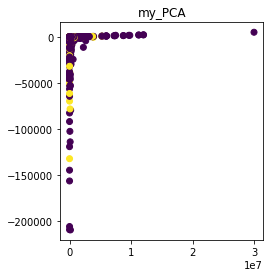

In [18]:
if __name__ == "__main__":
    x = data.iloc[:,:-1]
    y = data.iloc[:,-1]
    data_2d1 = pca(x, 50)
    plt.figure(figsize=(8,4))
    plt.subplot(121)
    plt.title("my_PCA")
    plt.scatter(data_2d1[:, 0], data_2d1[:, 1], c = y)


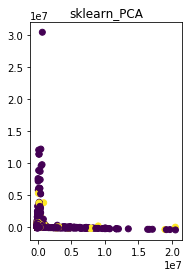

In [20]:
if __name__ == "__main__":
    data = data
    x = data.iloc[:,:-1]
    y = data.iloc[:,-1]

    sklearn_pca = PCA(n_components=50)
    data_2d2 = sklearn_pca.fit_transform(x)
    plt.subplot(122)
    plt.title("sklearn_PCA")
    plt.scatter(data_2d2[:, 0], data_2d2[:, 1], c = y)
    plt.show()

In [54]:
pd.DataFrame(data_2d2).to_csv(r'C:\Users\13479\Desktop\dataset\PCA.csv')


Running PCA again ...
Explained variance: 1.0000
Individual variance contributions:
0.8566198624453457
0.04965987655189493
0.03354925139770295
0.019817225493467577
0.011198391567857582
0.0075002846056361466
0.006320769838220217
0.003618895746422687
0.0023733561019795963
0.0019256828470198075
0.0011353164698355283
0.0010611137335009536
0.0007895381630999155
0.0006931761499027777
0.0006176945105655911
0.000546927033198807
0.00042826984983211755
0.00037212918583750035
0.0003033531121725099
0.0002008119483786732
0.0001913647352851295
0.00015126123287142427
0.0001349255010321334
0.00011538496029005123
9.47545619283615e-05
8.86445189294655e-05
7.729908289793977e-05
5.444139935954408e-05
5.0461551279267966e-05
3.919186658665534e-05
3.841510541749272e-05
3.093661868860048e-05
2.979260956037927e-05
2.702001180217109e-05
2.4632097132622858e-05
2.2218426351205323e-05
1.746614186561613e-05
1.666669527742818e-05
1.5208905875408356e-05
1.2655720611367071e-05
1.0606119488055983e-05
6.440430400829301

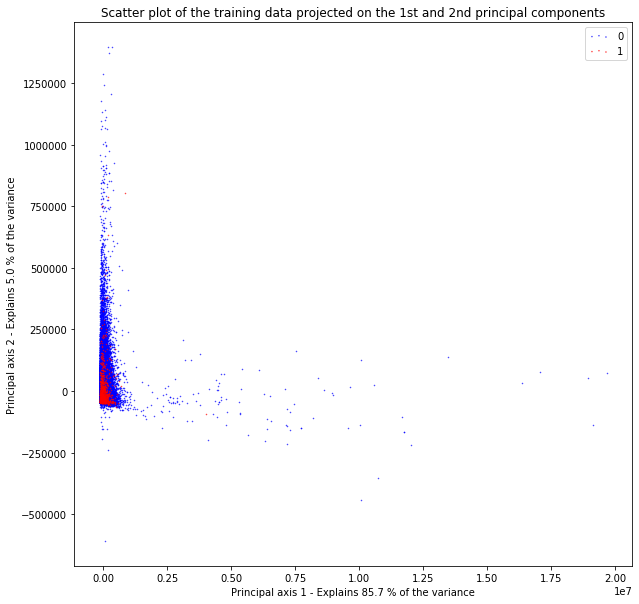

In [11]:
X = data.iloc[:,:-1]
y = data.iloc[:,-1].values.astype(np.int8)
target_names = np.unique(y)
colors = ['blue', 'red']
print('\nRunning PCA again ...')
pca = PCA(n_components=50, svd_solver='full', random_state=1001)
X_pca = pca.fit_transform(X)
print('Explained variance: %.4f' % pca.explained_variance_ratio_.sum())

print('Individual variance contributions:')
for j in range(50):
    print(pca.explained_variance_ratio_[j])

plt.figure(1, figsize=(10, 10))

for color, i, target_name in zip(colors, [0, 1], target_names):
    plt.scatter(X_pca[y == i, 0], X_pca[y == i, 1], color=color, s=1,
                alpha=.8, label=target_name, marker='.')
plt.legend(loc='best', shadow=False, scatterpoints=3)
plt.title(
        "Scatter plot of the training data projected on the 1st "
        "and 2nd principal components")
plt.xlabel("Principal axis 1 - Explains %.1f %% of the variance" % (
        pca.explained_variance_ratio_[0] * 100.0))
plt.ylabel("Principal axis 2 - Explains %.1f %% of the variance" % (
        pca.explained_variance_ratio_[1] * 100.0))
plt.show()

### Kernel PCA 

In [55]:
def sigmoid(x, coef = 0.25):
    x = np.dot(x, x.T)
    return np.tanh(coef*x+1)

In [56]:
def linear(x):
    x = np.dot(x, x.T)
    return x

In [57]:
def rbf(x, gamma = 15):
    sq_dists = pdist(x, 'sqeuclidean')
    mat_sq_dists = squareform(sq_dists)
    return np.exp(-gamma*mat_sq_dists)

In [61]:
def kpca(data, n_dims=50, kernel = rbf):
    '''
    :param data: (n_samples, n_features)
    :param n_dims: target n_dims
    :param kernel: kernel functions
    :return: (n_samples, n_dims)
    '''

    K = kernel(data)
    #
    N = K.shape[0]
    one_n = np.ones((N, N)) / N
    K = K - one_n.dot(K) - K.dot(one_n) + one_n.dot(K).dot(one_n)
    #
    eig_values, eig_vector = np.linalg.eig(K)
    idx = eig_values.argsort()[::-1]
    eigval = eig_values[idx][:n_dims]
    eigvector = eig_vector[:, idx][:, :n_dims]
    print(eigval)
    eigval = eigval**(1/2)
    vi = eigvector/eigval.reshape(-1,n_dims)
    data_n = np.dot(K, vi)
    return data_n

In [ ]:
if __name__ == "__main__":
    x = data.iloc[:,:-1]
    y = data.iloc[:,-1]
    data_1 = kpca(x, kernel=rbf)




In [ ]:
if __name__ == "__main__":
    df=df.fillna(0)
    x = df.iloc[:,:-1]
    y = df.iloc[:,-1]

    sklearn_kpca = KernelPCA(n_components=50, kernel="rbf", gamma=15)
    data_2 = sklearn_kpca.fit_transform(x)


    plt.subplot(122)
    plt.title("sklearn_KPCA")
    plt.scatter(data_2[:, 0], data_2[:, 1], c = y)
    plt.show()

In [2]:
os.chdir(r"C:\Users\13479\Desktop")

In [3]:
data = pd.read_csv('KPCA (2).csv')

In [12]:
data.head()

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,91,92,93,94,95,96,97,98,99,bad30
0,0,-0.002232,-0.000301,-0.000050,-0.000652,0.000524,-0.000832,0.000000,0.000000,-0.000796,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0
1,1,0.029766,0.126819,0.021205,0.260700,-0.192873,-0.130065,-0.000005,-0.000040,-0.004249,...,0.000016,0.000006,-0.000022,-0.000037,-0.000009,-0.000014,8.070000e-06,-0.000001,0.000003,1
2,2,0.015525,0.110652,0.012041,0.308472,-0.279045,0.583744,-0.000019,-0.000038,-0.001654,...,-0.000013,0.000002,0.000037,0.000039,0.000018,0.000010,-6.720000e-06,0.000002,0.000011,0
3,3,-0.024652,-0.116331,-0.020669,-0.198095,0.106572,0.641646,-0.000074,-0.000098,-0.021087,...,0.000007,-0.000003,-0.000056,-0.000033,-0.000040,-0.000021,6.080000e-07,-0.000012,-0.000008,0
4,4,-0.002396,-0.018249,-0.004598,-0.027039,0.027119,-0.031325,-0.000843,0.000781,-0.035073,...,-0.000140,-0.000062,-0.000049,0.000190,-0.000226,0.000022,1.470000e-05,-0.000035,0.000220,0


In [7]:
data[['0']]

,0
0,-0.002232
1,0.029766
2,0.015525
3,-0.024652
4,-0.002396
...,...
64063,0.000393
64064,0.000489
64065,0.000384
64066,0.000756


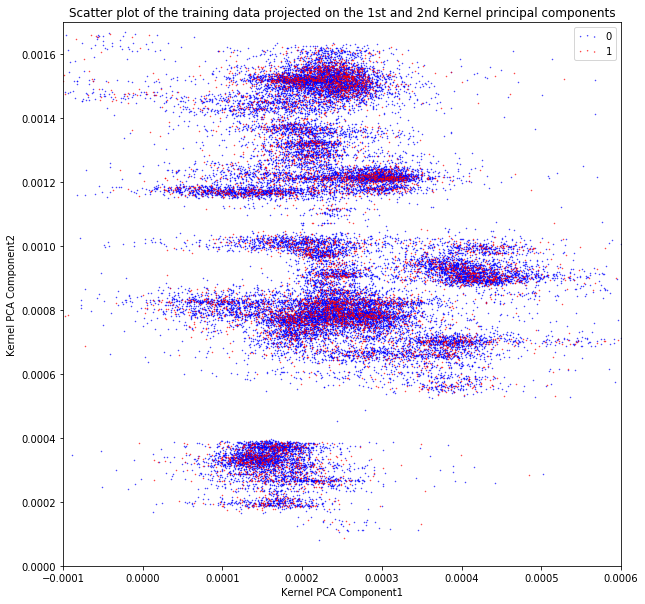

In [55]:
x = data.iloc[:,:-1].to_numpy()
y = data.iloc[:,-1].values.astype(np.int8)
target_names = np.unique(y)
colors = ['blue', 'red']
plt.figure(1, figsize=(10, 10))

for color, i, target_name in zip(colors, [0, 1], target_names):
    plt.scatter(x[y == i, 1], x[y == i, 2], color=color, s=1,
                alpha=.8, label=target_name, marker='.')
plt.legend(loc='best', shadow=False, scatterpoints=3)
plt.title(
        "Scatter plot of the training data projected on the 1st "
        "and 2nd Kernel principal components")
plt.xlabel('Kernel PCA Component1')
plt.ylabel('Kernel PCA Component2')
plt.ylim(0,0.00170)
plt.xlim(-0.0001,0.0006)
plt.show()

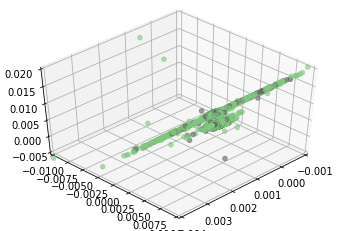

In [79]:
ax = plt.axes(projection='3d')
ax.scatter3D(x[:,1], x[:,2],x[:,3], c=y, cmap='Accent')
ax.set_ylim(-0.01,0.01)
ax.set_xlim(-0.001,0.004)
ax.set_zlim(-0.005,0.02)
ax.view_init(45, 45)

In [4]:
fig = px.scatter_3d(data, x='0', y='1', z='2',
                    color='bad30')
fig.show()

## T-SNE

In [2]:
def cal_pairwise_dist(x):
    '''
    (a-b)^2 = a^2 + b^2 - 2*a*b
    '''
    sum_x = np.sum(np.square(x), 1)
    dist = np.add(np.add(-2 * np.dot(x, x.T), sum_x).T, sum_x)
    return dist

In [3]:
def cal_perplexity(dist, idx=0, beta=1.0):

    prob = np.exp(-dist * beta)

    prob[idx] = 0
    sum_prob = np.sum(prob)
    if sum_prob < 1e-12:
        prob = np.maximum(prob, 1e-12)
        perp = -12
    else:
        perp = np.log(sum_prob) + beta * np.sum(dist * prob) / sum_prob
        prob /= sum_prob

    return perp, prob

In [5]:
def seach_prob(x, tol=1e-5, perplexity=30.0):


    print("Computing pairwise distances...")
    (n, d) = x.shape
    dist = cal_pairwise_dist(x)
    pair_prob = np.zeros((n, n))
    beta = np.ones((n, 1))

    base_perp = np.log(perplexity)

    for i in range(n):
        if i % 500 == 0:
            print("Computing pair_prob for point %s of %s ..." %(i,n))

        betamin = -np.inf
        betamax = np.inf
        perp, this_prob = cal_perplexity(dist[i], i, beta[i])

        perp_diff = perp - base_perp
        tries = 0
        while np.abs(perp_diff) > tol and tries < 50:
            if perp_diff > 0:
                betamin = beta[i].copy()
                if betamax == np.inf or betamax == -np.inf:
                    beta[i] = beta[i] * 2
                else:
                    beta[i] = (beta[i] + betamax) / 2
            else:
                betamax = beta[i].copy()
                if betamin == np.inf or betamin == -np.inf:
                    beta[i] = beta[i] / 2
                else:
                    beta[i] = (beta[i] + betamin) / 2

        
            perp, this_prob = cal_perplexity(dist[i], i, beta[i])
            perp_diff = perp - base_perp
            tries = tries + 1

        pair_prob[i,] = this_prob
    print("Mean value of sigma: ", np.mean(np.sqrt(1 / beta)))
    ticks = time.time()
    print ("当前时间戳为:", ticks)

    return pair_prob

In [7]:
def tsne(x, no_dims= 50, perplexity=30.0, max_iter=1000):
    """Runs t-SNE on the dataset in the NxD array x
    to reduce its dimensionality to no_dims dimensions.
    The syntaxis of the function is Y = tsne.tsne(x, no_dims, perplexity),
    where x is an NxD NumPy array.
    """

    # Check inputs
    if isinstance(no_dims, float):
        print("Error: array x should have type float.")
        return -1

    (n, d) = x.shape

    initial_momentum = 0.5
    final_momentum = 0.8
    eta = 500
    min_gain = 0.01
    y = np.random.randn(n, no_dims)
    
    dy = np.zeros((n, no_dims))
    
    iy = np.zeros((n, no_dims))

    gains = np.ones((n, no_dims))


    P = seach_prob(x, 1e-5, perplexity)
    P = P + np.transpose(P)
    P = P / np.sum(P)   #pij
    # early exaggeration

    print ("T-SNE DURING:%s" % time.clock())
    P = P * 4
    P = np.maximum(P, 1e-12)

    # Run iterations
    for iter in range(max_iter):
        # Compute pairwise affinities
        sum_y = np.sum(np.square(y), 1)
        num = 1 / (1 + np.add(np.add(-2 * np.dot(y, y.T), sum_y).T, sum_y))
        num[range(n), range(n)] = 0
        Q = num / np.sum(num)   #qij
        Q = np.maximum(Q, 1e-12)    

        # Compute gradient
        
        # pij-qij
        PQ = P - Q
        
        for i in range(n):
            dy[i,:] = np.sum(np.tile(PQ[:,i] * num[:,i], (no_dims, 1)).T * (y[i,:] - y), 0)

        # Perform the update
        if iter < 20:
            momentum = initial_momentum
        else:
            momentum = final_momentum

        gains = (gains + 0.2) * ((dy > 0) != (iy > 0)) + (gains * 0.8) * ((dy > 0) == (iy > 0))
        gains[gains < min_gain] = min_gain
        
        iy = momentum * iy - eta * (gains * dy)
        y = y + iy
        y = y - np.tile(np.mean(y, 0), (n, 1))
        # Compute current value of cost function\
        if (iter + 1) % 100 == 0:
            C = np.sum(P * np.log(P / Q))
            print("Iteration ", (iter + 1), ": error is ", C)
            if (iter+1) != 100:
                ratio = C/oldC
                print("ratio ", ratio)
                if ratio >= 0.95:
                    break
            oldC = C
        # Stop lying about P-values
        if iter == 100:
            P = P / 4
    print("finished training!")
    return y

In [ ]:
if __name__ == "__main__":
    data = data
    x = data.iloc[:,:-1]
    y = data.iloc[:,-1]

    data_2d = tsne(x, 2)
    plt.scatter(data_2d[:, 0], data_2d[:, 1], c = y)
    plt.show()

Computing pairwise distances...


KeyboardInterrupt: 

In [26]:
TSNE = pd.read_csv('TSNE.csv')

In [27]:
TSNE.head()

,Unnamed: 0,0,1,2,bad30
0,0,-3.346907,-10.512367,-10.241929,0
1,1,-11.711383,-5.310298,11.171701,1
2,2,-13.726511,-0.812788,-5.300848,0
3,3,-5.699328,-5.267158,6.106090,0
4,4,6.673297,-4.435125,1.568400,0


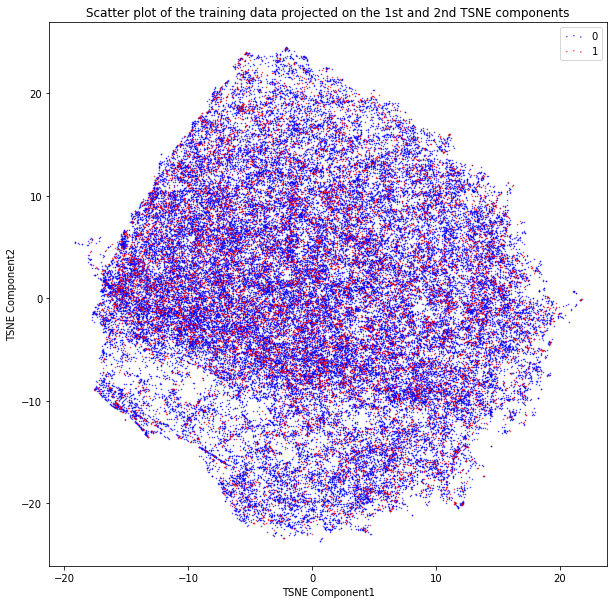

In [33]:
x = TSNE.iloc[:,:-1].to_numpy()
y = TSNE.iloc[:,-1].values.astype(np.int8)
target_names = np.unique(y)
colors = ['blue', 'red']
plt.figure(1, figsize=(10, 10))

for color, i, target_name in zip(colors, [0, 1], target_names):
    plt.scatter(x[y == i,1], x[y == i,2], color=color, s=1,
                alpha=.8, label=target_name, marker='.')
plt.legend(loc='best', shadow=False, scatterpoints=3)
plt.title(
        "Scatter plot of the training data projected on the 1st "
        "and 2nd TSNE components")
plt.xlabel('TSNE Component1')
plt.ylabel('TSNE Component2')
plt.show()

lots of clusters, but blue and red dots overlap for the most part.


 (1) This just happens to be a difficult classification classification problem, so maybe it is not a big surprise that raw data      does not contain enough info for t-SNE to distinguish clearly between the classes.
 
 (2) Current hyperparameter doesn't fit the data very well
 
 (3) we are using the barnes-hut method to reduce space/ time complexity for TSNE from n^3 to nlogn, which just gives us a approximate result  

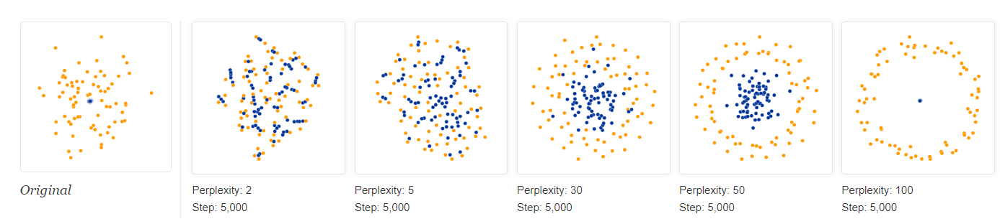

In [35]:
fig = px.scatter_3d(TSNE, x='0', y='1', z='2',
                    color='bad30')
fig.show()

## LLE

In [3]:
if __name__ == '__main__':
    data = pd.read_csv('rmNA.csv')
    data=data.fillna(0)
    x = data.iloc[:,:-1]
    y = data.iloc[:,-1]
    
    data_2 = LocallyLinearEmbedding(n_components=50, n_neighbors=30).fit_transform(x)
    plt.figure(figsize=(8,4))

    plt.subplot(122)
    plt.title("sklearn_LLE")
    plt.scatter(data_2[:, 0], data_2[:, 1], c = y)
    plt.savefig("LLE.png")
    plt.show()

MemoryError: 

In [5]:
LLE = pd.read_csv('LLE.csv')

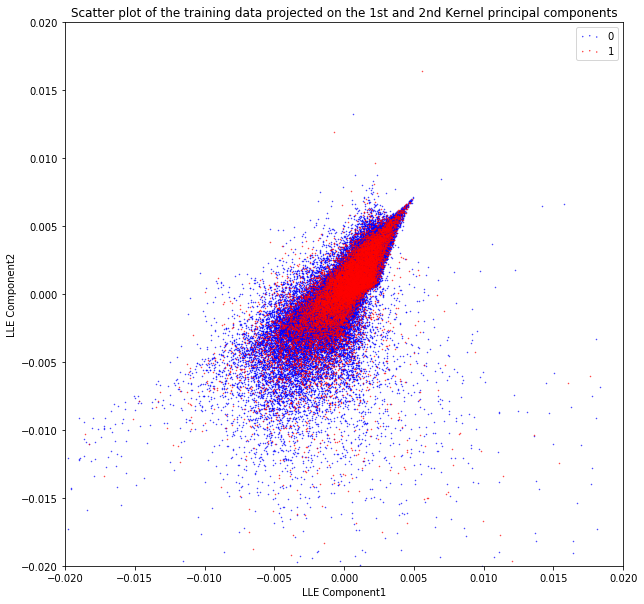

In [32]:
x = LLE.iloc[:,:-1].to_numpy()
y = LLE.iloc[:,-1].values.astype(np.int8)
target_names = np.unique(y)
colors = ['blue', 'red']
plt.figure(1, figsize=(10, 10))

for color, i, target_name in zip(colors, [0, 1], target_names):
    plt.scatter(x[y == i,1], x[y == i,2], color=color, s=1,
                alpha=.8, label=target_name, marker='.')
plt.legend(loc='best', shadow=False, scatterpoints=3)
plt.title(
        "Scatter plot of the training data projected on the 1st "
        "and 2nd Kernel principal components")
plt.xlabel('LLE Component1')
plt.ylabel('LLE Component2')
plt.ylim(-0.02,0.02)
plt.xlim(-0.02,0.02)
plt.show()

In [24]:
fig = px.scatter_3d(LLE, x='0', y='1', z='2',
                    color='bad30')
fig.show()